In [ ]:

import cellpose
from cellpose import models, io, core, plot
from cellpose import utils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib 
import os
import glob
from glob import glob

In [ ]:
%matplotlib inline
matplotlib.rcParams['figure.dpi'] = 300

In [ ]:
!nvcc --version
!nvidia-smi

In [ ]:
use_GPU = core.use_gpu()
print('>>> GPU activated? %d'%use_GPU)

In [6]:
from cellpose.io import logger_setup
logger_setup();

2024-02-02 09:21:00,750 [INFO] WRITING LOG OUTPUT TO /home/users/allstaff/kriel.j/.cellpose/run.log
2024-02-02 09:21:00,750 [INFO] 
cellpose version: 	2.2.2 
platform:       	linux 
python version: 	3.11.7 
torch version:  	2.0.0+cu117


In [106]:
#train models on image tiles 


#start logger (to see training across epochs)
logger = io.logger_setup()

# DEFINE CELLPOSE MODEL (without size model)
CP2='/home/users/allstaff/kriel.j/.cellpose/models/CP_20240119_101700'
model=models.CellposeModel(gpu=use_GPU,pretrained_model=CP2)
train_dir='/stornext/Bioinf/data/lab_brain_cancer/users/j_kriel/Confocal/Venture_2_1/output_tiles/training_647488combined/combined_images/retrain/'
test_dir='/stornext/Bioinf/data/lab_brain_cancer/users/j_kriel/Confocal/Venture_2_1/output_tiles/training_647488combined/combined_images/test_files/'
#model = models.CellposeModel(gpu=use_GPU, model_type=initial_model)

# set channels
channels = [1,2]

# get files
output = io.load_train_test_data(train_dir, test_dir, mask_filter='_seg.npy')
train_files, train_seg, _, test_data, test_labels, _ = output

new_model_path = model.train(train_files, train_seg, 
                              test_data=test_data,
                              test_labels=test_labels,
                              channels=channels, 
                              save_path=train_dir, 
                              n_epochs=1000,
                              learning_rate=0.01, 
                              weight_decay=0.00001, 
                              nimg_per_epoch=1,
                              model_name=CP2)

# diameter of labels in training images
diam_labels = model.diam_labels.copy()

2024-01-26 20:19:09,874 [INFO] WRITING LOG OUTPUT TO /home/users/allstaff/kriel.j/.cellpose/run.log
2024-01-26 20:19:09,875 [INFO] 
cellpose version: 	2.2.3 
platform:       	linux 
python version: 	3.11.7 
torch version:  	2.1.2
2024-01-26 20:19:09,876 [INFO] >>>> loading model /home/users/allstaff/kriel.j/.cellpose/models/CP_20240119_101700
2024-01-26 20:19:09,876 [INFO] ** TORCH CUDA version installed and working. **
2024-01-26 20:19:09,877 [INFO] >>>> using GPU
2024-01-26 20:19:09,998 [INFO] >>>> model diam_mean =  30.000 (ROIs rescaled to this size during training)
2024-01-26 20:19:09,998 [INFO] >>>> model diam_labels =  100.880 (mean diameter of training ROIs)
2024-01-26 20:19:10,004 [INFO] not all flows are present, running flow generation for all images
2024-01-26 20:19:18,438 [INFO] 40 / 40 images in /stornext/Bioinf/data/lab_brain_cancer/users/j_kriel/Confocal/Venture_2_1/output_tiles/training_647488combined/combined_images/retrain/ folder have labels
2024-01-26 20:19:18,442 

100%|██████████| 40/40 [01:12<00:00,  1.81s/it]


2024-01-26 20:21:22,394 [INFO] >>>> median diameter set to = 30
2024-01-26 20:21:22,395 [INFO] >>>> mean of training label mask diameters (saved to model) 100.567
2024-01-26 20:21:22,396 [INFO] >>>> training network with 2 channel input <<<<
2024-01-26 20:21:22,396 [INFO] >>>> LR: 0.01000, batch_size: 8, weight_decay: 0.00001
2024-01-26 20:21:22,396 [INFO] >>>> ntrain = 40
2024-01-26 20:21:22,398 [INFO] >>>> nimg_per_epoch = 40
2024-01-26 20:21:26,533 [INFO] Epoch 0, Time  4.1s, Loss 0.4149, LR 0.0000
2024-01-26 20:21:30,168 [INFO] saving network parameters to /home/users/allstaff/kriel.j/.cellpose/models/CP_20240119_101700
2024-01-26 20:21:45,586 [INFO] Epoch 5, Time 23.2s, Loss 0.4335, LR 0.0056
2024-01-26 20:22:03,822 [INFO] Epoch 10, Time 41.4s, Loss 0.4144, LR 0.0100
2024-01-26 20:22:41,841 [INFO] Epoch 20, Time 79.4s, Loss 0.4198, LR 0.0100
2024-01-26 20:23:19,305 [INFO] Epoch 30, Time 116.9s, Loss 0.4240, LR 0.0100
2024-01-26 20:23:57,290 [INFO] Epoch 40, Time 154.9s, Loss 0.423

2024-01-26 21:15:21,499 [INFO] Epoch 840, Time 3239.1s, Loss 0.3775, LR 0.0100
2024-01-26 21:15:59,806 [INFO] Epoch 850, Time 3277.4s, Loss 0.3962, LR 0.0100
2024-01-26 21:16:37,214 [INFO] Epoch 860, Time 3314.8s, Loss 0.3868, LR 0.0100
2024-01-26 21:17:15,564 [INFO] Epoch 870, Time 3353.2s, Loss 0.3936, LR 0.0100
2024-01-26 21:17:53,522 [INFO] Epoch 880, Time 3391.1s, Loss 0.4048, LR 0.0100
2024-01-26 21:18:32,231 [INFO] Epoch 890, Time 3429.8s, Loss 0.3756, LR 0.0100
2024-01-26 21:19:09,809 [INFO] Epoch 900, Time 3467.4s, Loss 0.3812, LR 0.0100
2024-01-26 21:19:13,707 [INFO] saving network parameters to /home/users/allstaff/kriel.j/.cellpose/models/CP_20240119_101700
2024-01-26 21:19:49,053 [INFO] Epoch 910, Time 3506.7s, Loss 0.3813, LR 0.0050
2024-01-26 21:20:27,279 [INFO] Epoch 920, Time 3544.9s, Loss 0.3727, LR 0.0025
2024-01-26 21:21:05,607 [INFO] Epoch 930, Time 3583.2s, Loss 0.3731, LR 0.0013
2024-01-26 21:21:43,123 [INFO] Epoch 940, Time 3620.7s, Loss 0.3803, LR 0.0006
2024-0

In [19]:
image_files = glob('/path/to/images/*.tif')


In [20]:
CP2='/path/to/custom/trained/model/CP_model/'
model=models.CellposeModel(gpu=use_GPU,pretrained_model=CP2)

2024-02-02 10:33:31,677 [INFO] >>>> loading model /home/users/allstaff/kriel.j/.cellpose/models/CP_20240119_101700
2024-02-02 10:33:31,678 [INFO] ** TORCH CUDA version installed and working. **
2024-02-02 10:33:31,678 [INFO] >>>> using GPU
2024-02-02 10:33:31,780 [INFO] >>>> model diam_mean =  30.000 (ROIs rescaled to this size during training)
2024-02-02 10:33:31,780 [INFO] >>>> model diam_labels =  100.567 (mean diameter of training ROIs)


In [21]:
#sort images as list
imgs=[]
for file in image_files:
    img=io.imread(file)
    imgs.append(img)

nimg=len(imgs)
nimg

6

In [25]:
#Run segmentation with CP2 model

channels = [1,2]
masks, flows, diams = model.eval(imgs, diameter=100.53, flow_threshold=3,cellprob_threshold=-3, channels=channels, min_size=99, normalize=True)
io.masks_flows_to_seg(imgs, masks, flows, diams, train_files, channels=channels)


2024-02-02 10:37:06,470 [INFO] 100%|##########| 6/6 [00:34<00:00,  5.68s/it]


In [ ]:
io.masks_flows_to_seg(imgs, masks, flows, diams, train_files, channels=channels)
io.save_masks(imgs, masks, flows, train_files, save_txt=True)

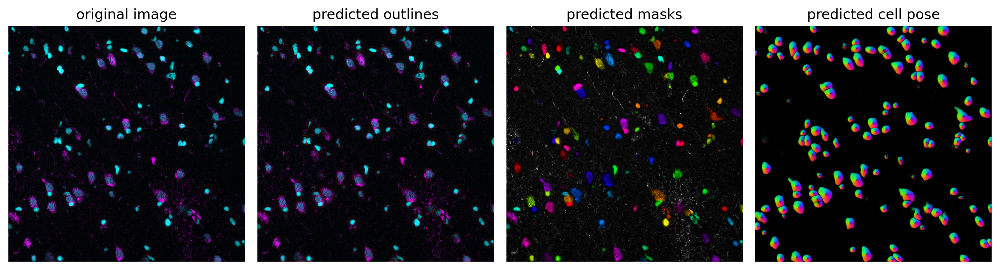

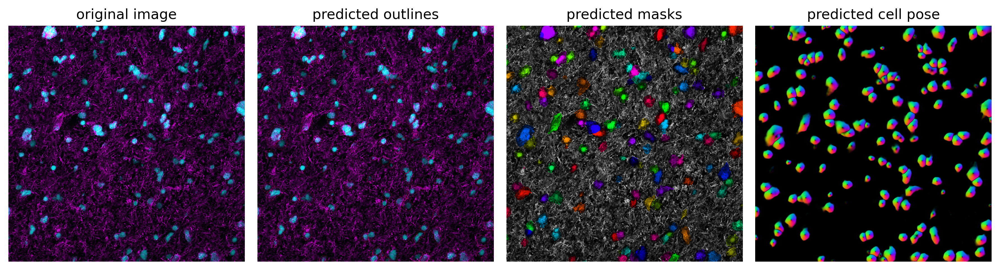

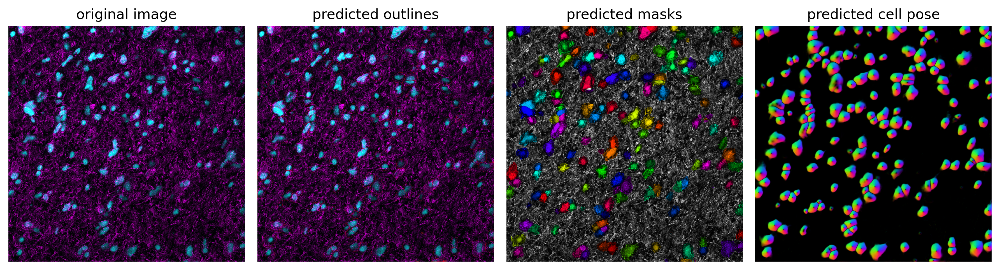

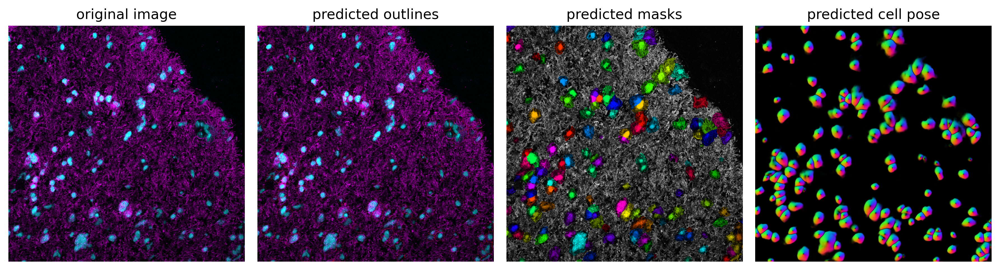

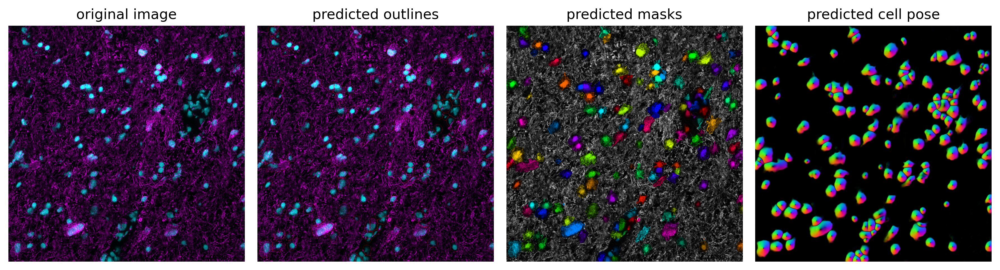

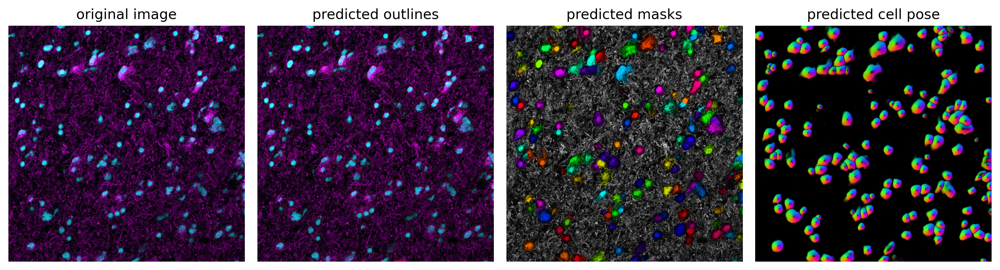

In [115]:
#assess segmentation results
nimg=len(imgs)
for idx in range(nimg):
    maski = masks[idx]
    flowi = flows[idx][0]

    fig = plt.figure(figsize=(12,5))
    plot.show_segmentation(fig, imgs[idx], maski, flowi, channels=channels)
    plt.tight_layout()
    plt.show()

<Figure size 1500x1500 with 0 Axes>

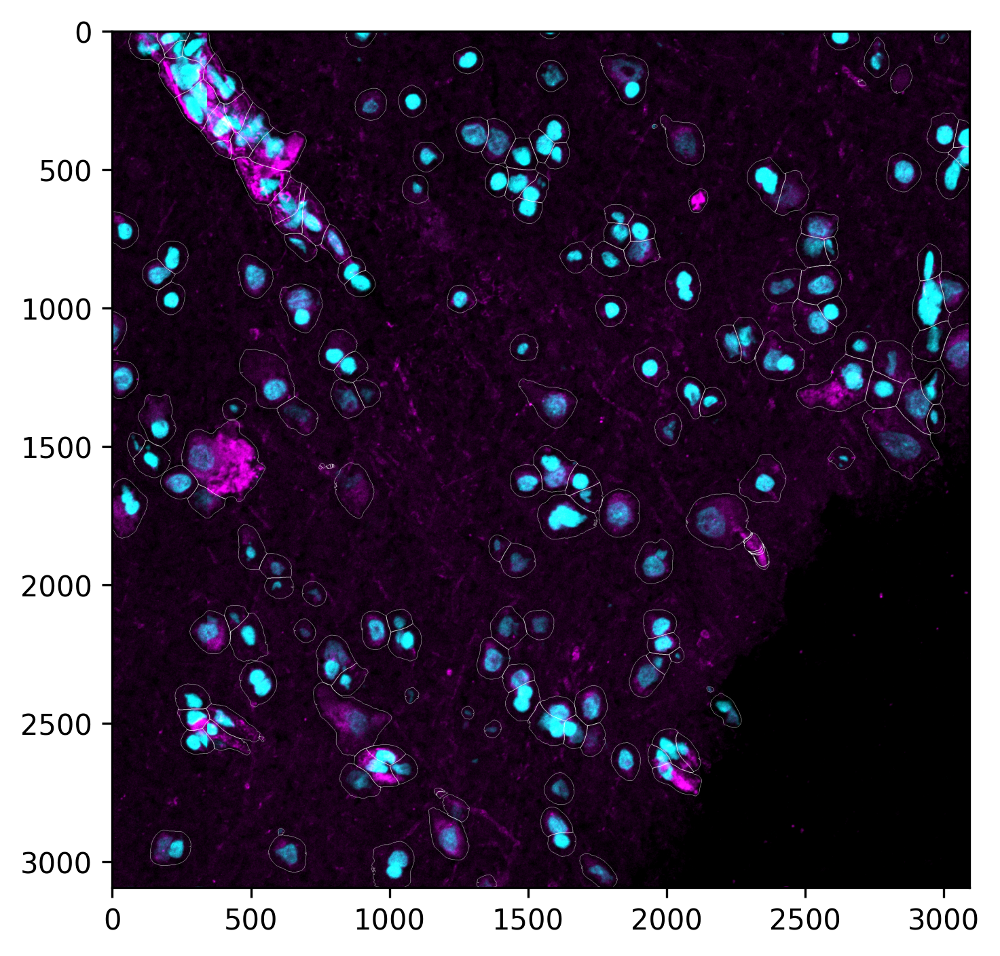

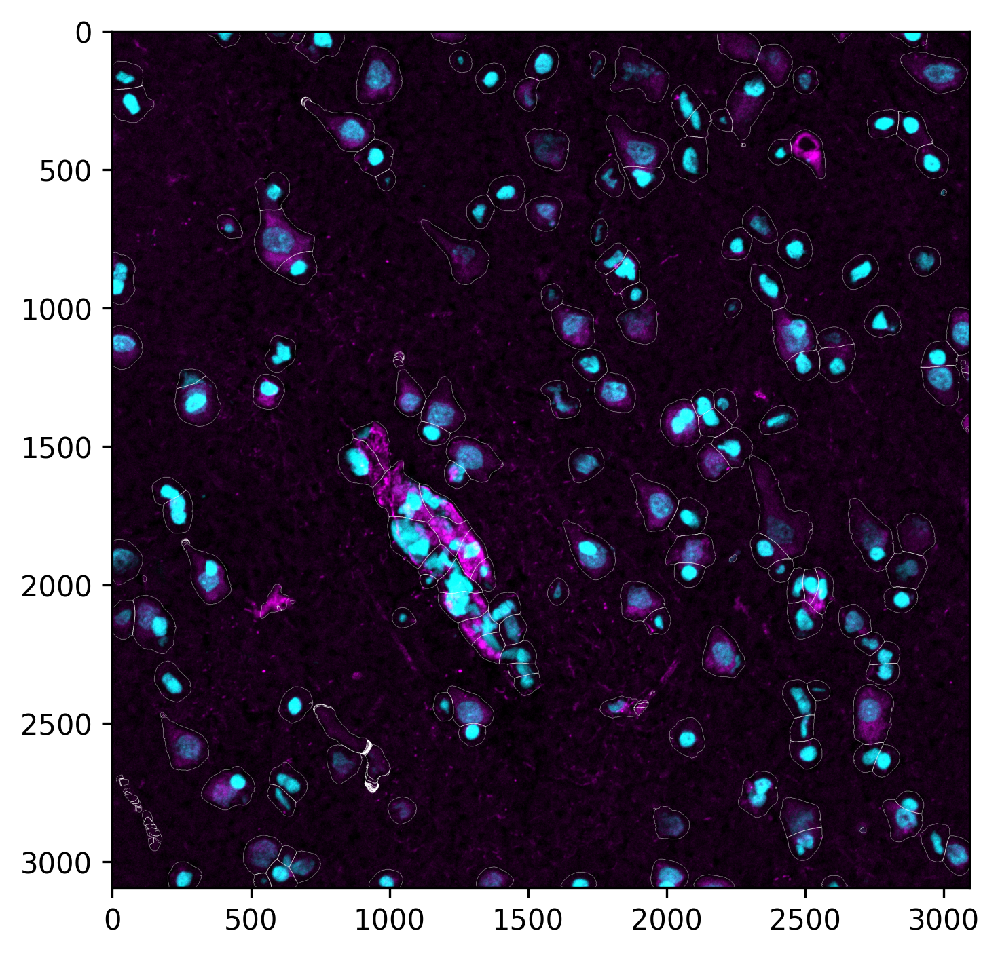

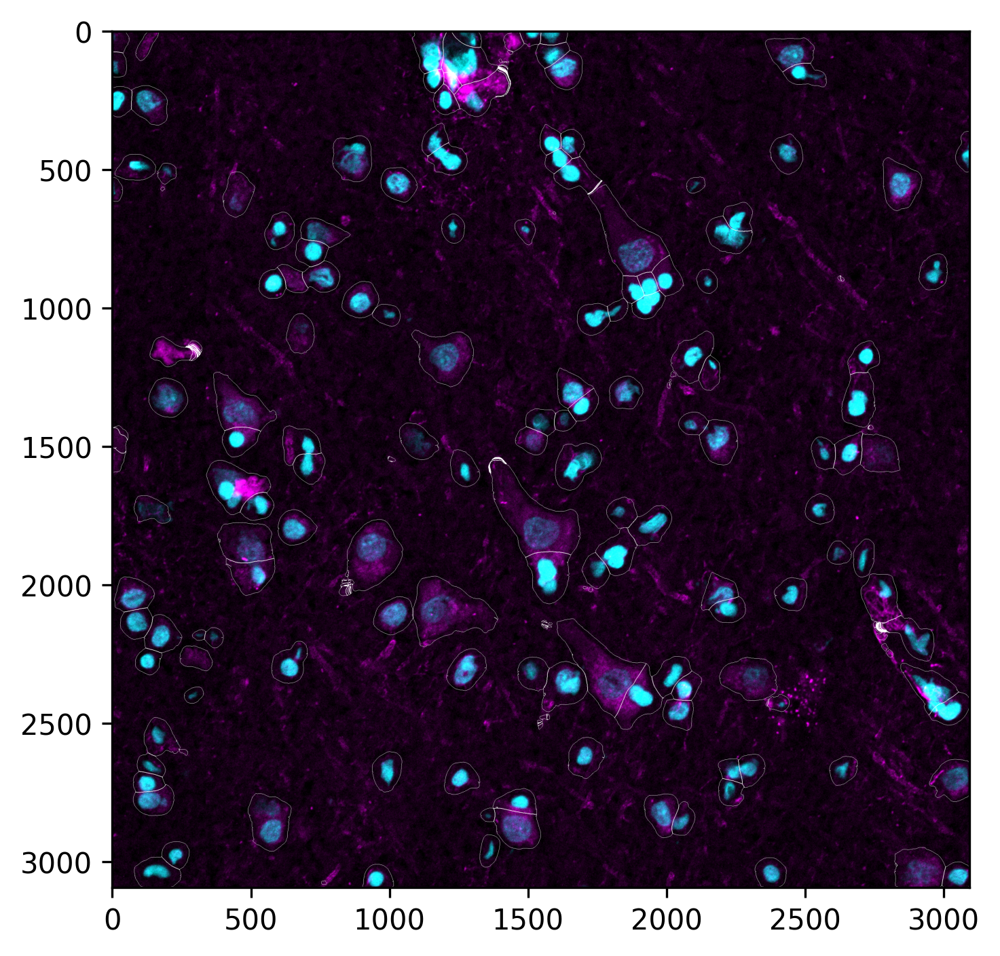

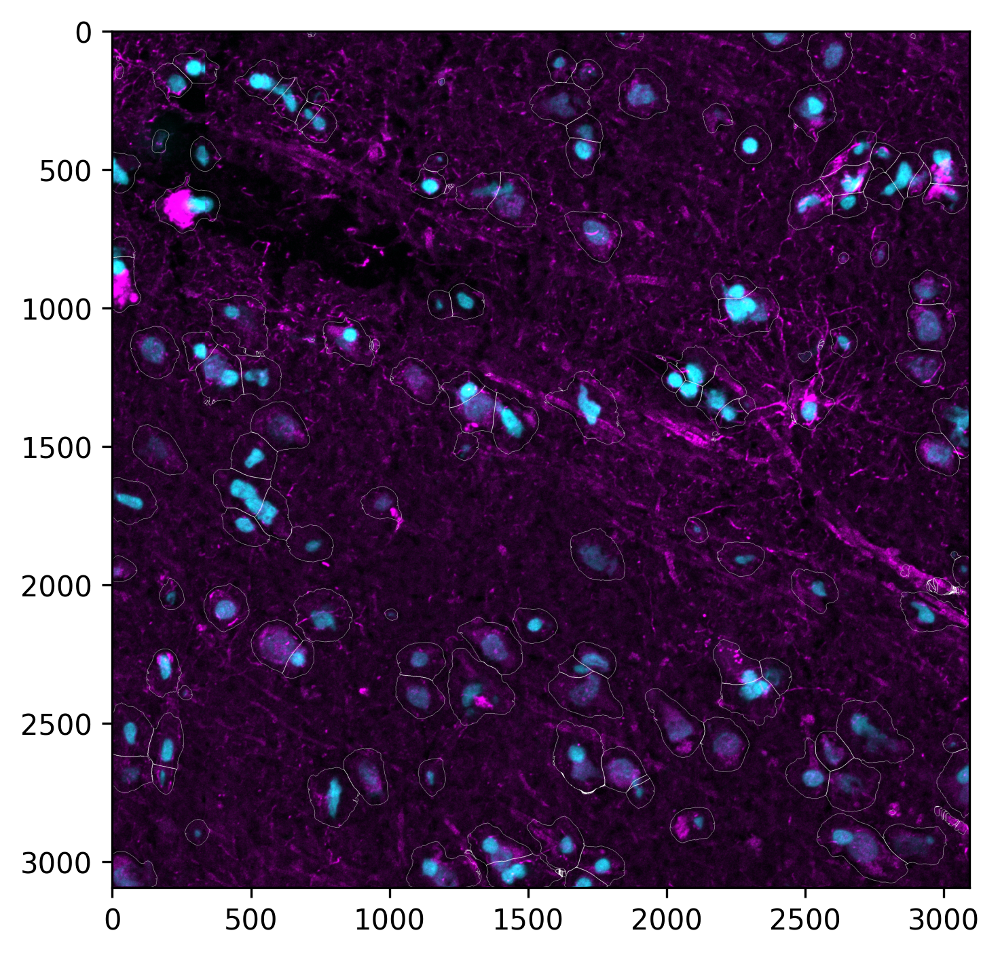

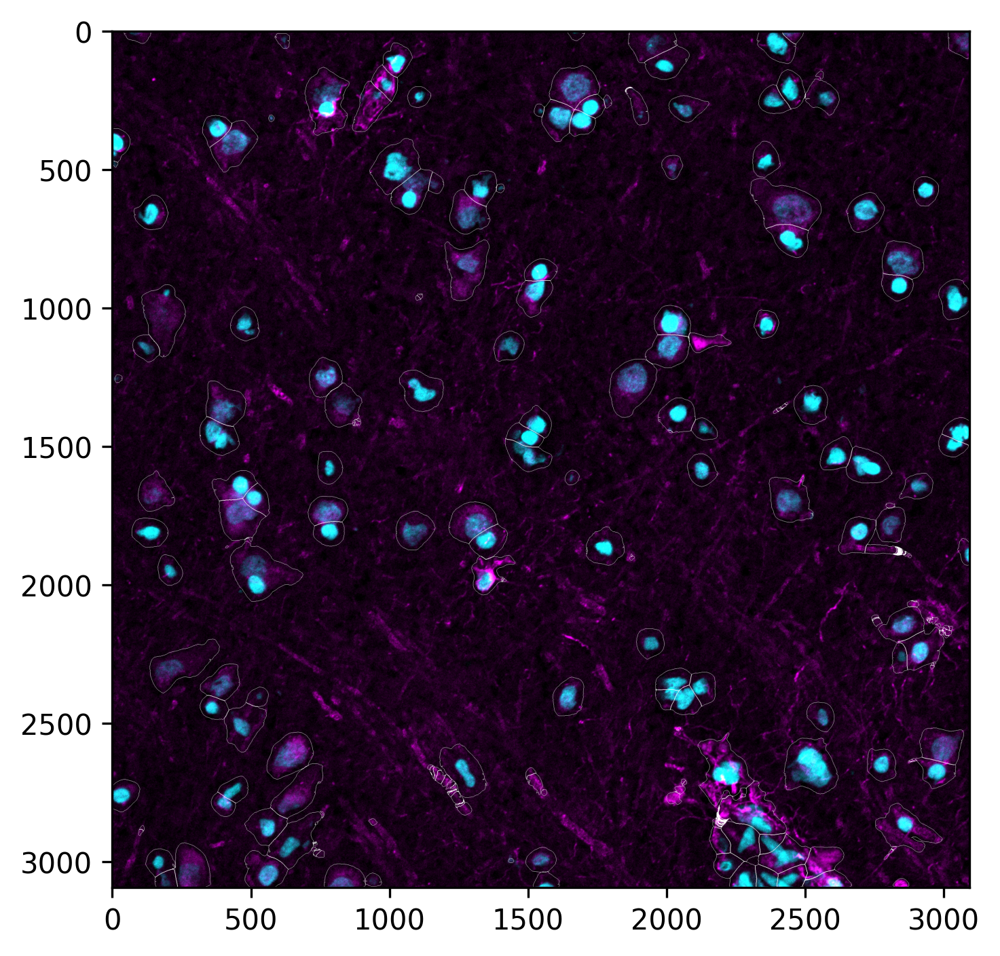

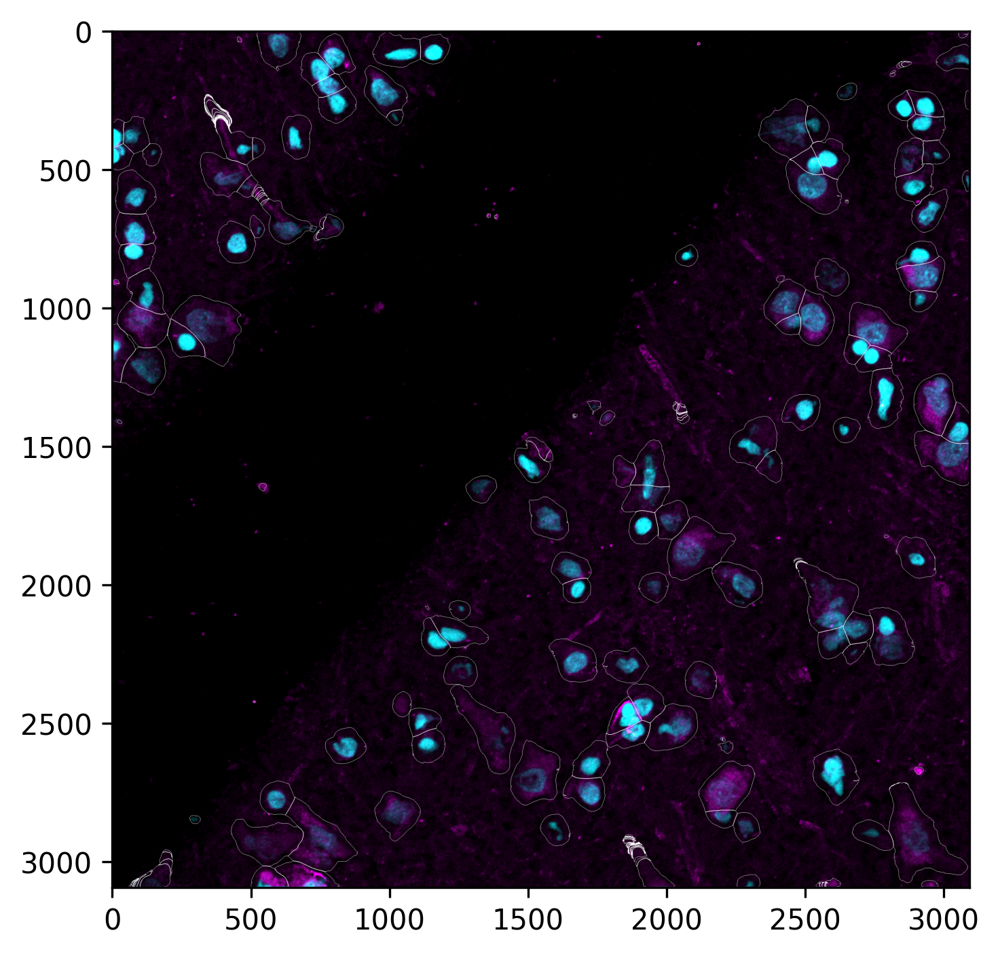

In [28]:
#assess outlines of segmentation results
nimg=len(imgs)
fig = plt.figure(figsize=(5,5))
for idx in range(nimg):
    maski = masks[idx]
    out=plot.outline_view(imgs[idx], maski, color=[255,255,255], mode='outer')   
    fig, ax=plt.subplots()
    plt.tight_layout()
    ax.imshow(out)

In [ ]:
CP2='/home/users/allstaff/kriel.j/.cellpose/models/CP_20240119_101700'
model=models.CellposeModel(gpu=use_GPU,pretrained_model=CP2)
channels=[1,2]
masks, flows, diams = model.eval(imgs, diameter=None, flow_threshold=2,cellprob_threshold=-2, channels=channels)

2024-01-29 11:34:19,328 [INFO] >>>> loading model /home/users/allstaff/kriel.j/.cellpose/models/CP_20240119_101700
2024-01-29 11:34:19,329 [INFO] ** TORCH CUDA version installed and working. **
2024-01-29 11:34:19,329 [INFO] >>>> using GPU
2024-01-29 11:34:19,445 [INFO] >>>> model diam_mean =  30.000 (ROIs rescaled to this size during training)
2024-01-29 11:34:19,446 [INFO] >>>> model diam_labels =  100.567 (mean diameter of training ROIs)
2024-01-29 11:42:40,410 [INFO] 20%|##        | 98/480 [08:20<39:17,  6.17s/it]


2024-01-29 11:51:44,221 [INFO] 42%|####1     | 201/480 [17:24<31:12,  6.71s/it]


2024-01-29 11:57:04,361 [INFO] 55%|#####5    | 266/480 [22:44<18:01,  5.05s/it]


In [54]:
io.masks_flows_to_seg(imgs, masks, flows, diams, train_files, channels=channels)
train_seg=glob('/stornext/Bioinf/data/lab_brain_cancer/users/j_kriel/Confocal/Venture_2_1/6887_bottom/Venture_PT2_6687_bottom-05-Orthogonal_stitched_tiles/composite/processed_tiles_rgb/*.npy')

In [24]:
nimg

6

In [14]:
CP2='/home/users/allstaff/kriel.j/.cellpose/models/CP_20240119_101500'
model=models.CellposeModel(gpu=use_GPU,pretrained_model=CP2)

2024-01-24 12:06:00,971 [INFO] >>>> loading model /home/users/allstaff/kriel.j/.cellpose/models/CP_20240119_101500
2024-01-24 12:06:00,972 [INFO] ** TORCH CUDA version installed and working. **
2024-01-24 12:06:00,972 [INFO] >>>> using GPU
2024-01-24 12:06:01,129 [INFO] >>>> model diam_mean =  30.000 (ROIs rescaled to this size during training)
2024-01-24 12:06:01,129 [INFO] >>>> model diam_labels =  97.944 (mean diameter of training ROIs)


In [175]:
channels = [1,2]
masks, flows, diams = model.eval(imgs, diameter=None, flow_threshold=None, channels=channels, normalize=True)

2024-01-19 13:28:22,012 [INFO] 100%|##########| 5/5 [00:14<00:00,  2.87s/it]
